# single-label

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from plantclef.spark import get_spark

spark = get_spark(
    cores=6,
    memory="16g",
)
display(spark)

Setting default log level to "WARN".
To adjust logging level use sc.setLogLevel(newLevel). For SparkR, use setLogLevel(newLevel).
25/06/07 16:48:35 WARN NativeCodeLoader: Unable to load native-hadoop library for your platform... using builtin-java classes where applicable
25/06/07 16:48:35 WARN SparkConf: Note that spark.local.dir will be overridden by the value set by the cluster manager (via SPARK_LOCAL_DIRS in mesos/standalone/kubernetes and LOCAL_DIRS in YARN).
25/06/07 16:48:36 WARN Utils: Service 'SparkUI' could not bind on port 4040. Attempting port 4041.


In [3]:
import os
from pathlib import Path

# Get list of stored filed in cloud bucket
root = Path(os.path.expanduser("~"))
! date

Sat Jun  7 16:48:37 EDT 2025


In [5]:
# Path and dataset names
project_data_path = f"{root}/scratch/plantclef/data"

# Define the path to the train parquet files
train_path = f"{project_data_path}/parquet/train"

# Read the parquet files into a spark DataFrame
train_df = spark.read.parquet(train_path)

# Show the data
train_df.printSchema()
train_df.show(n=5)

root
 |-- image_name: string (nullable = true)
 |-- path: string (nullable = true)
 |-- data: binary (nullable = true)
 |-- organ: string (nullable = true)
 |-- species_id: integer (nullable = true)
 |-- obs_id: long (nullable = true)
 |-- license: string (nullable = true)
 |-- partner: string (nullable = true)
 |-- author: string (nullable = true)
 |-- altitude: double (nullable = true)
 |-- latitude: double (nullable = true)
 |-- longitude: double (nullable = true)
 |-- gbif_species_id: string (nullable = true)
 |-- species: string (nullable = true)
 |-- genus: string (nullable = true)
 |-- family: string (nullable = true)
 |-- dataset: string (nullable = true)
 |-- publisher: string (nullable = true)
 |-- references: string (nullable = true)
 |-- url: string (nullable = true)
 |-- learn_tag: string (nullable = true)
 |-- image_backup_url: string (nullable = true)



+--------------------+--------------------+--------------------+------+----------+----------+--------------------+-------+-----------------+--------+------------------+------------------+---------------+--------------------+----------------+--------------+--------+-----------+--------------------+--------------------+---------+--------------------+
|          image_name|                path|                data| organ|species_id|    obs_id|             license|partner|           author|altitude|          latitude|         longitude|gbif_species_id|             species|           genus|        family| dataset|  publisher|          references|                 url|learn_tag|    image_backup_url|
+--------------------+--------------------+--------------------+------+----------+----------+--------------------+-------+-----------------+--------+------------------+------------------+---------------+--------------------+----------------+--------------+--------+-----------+--------------------+

In [8]:
subset_df = train_df.limit(100)
subset_df.show(n=5)

+--------------------+--------------------+--------------------+------+----------+----------+--------------------+-------+-----------------+--------+------------------+------------------+---------------+--------------------+----------------+--------------+--------+-----------+--------------------+--------------------+---------+--------------------+
|          image_name|                path|                data| organ|species_id|    obs_id|             license|partner|           author|altitude|          latitude|         longitude|gbif_species_id|             species|           genus|        family| dataset|  publisher|          references|                 url|learn_tag|    image_backup_url|
+--------------------+--------------------+--------------------+------+----------+----------+--------------------+-------+-----------------+--------+------------------+------------------+---------------+--------------------+----------------+--------------+--------+-----------+--------------------+

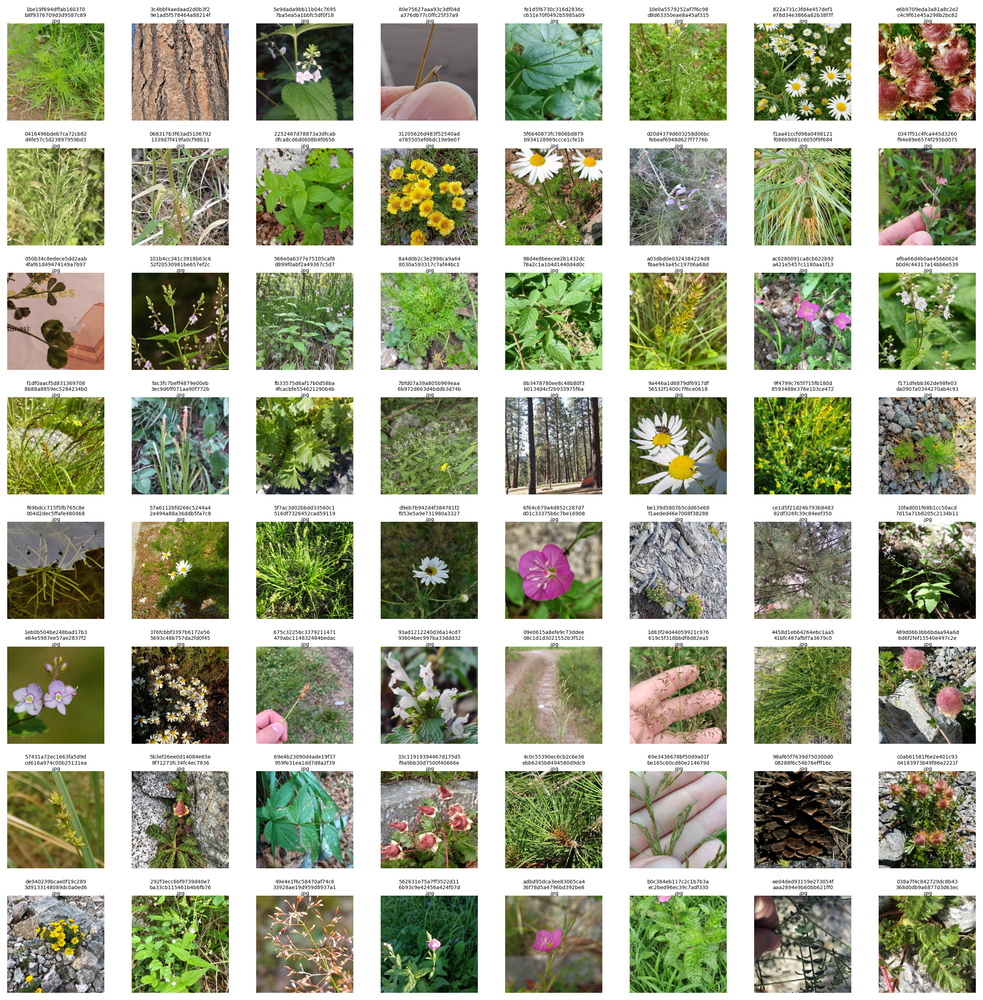

In [27]:
from plantclef.plotting import plot_images_from_binary


plot_images_from_binary(
    subset_df,
    data_col="data",
    label_col="image_name",
    grid_size=(8, 8),
    crop_square=True,
    figsize=(14, 14),  # 14, 12
    fontsize=5,
    text_width=20,
    dpi=200,
)

In [15]:
img_names = subset_df.select("image_name").distinct().collect()

In [31]:
for name in img_names:
    if name.image_name.startswith("93ad"):
        print(name.image_name)

93ad1212240d36a14cd793604bec997ba33ddd32.jpg


In [32]:
image_names = [
    "822a731c3fd4e457def1e78d34e3866a82b38f7f.jpg",
    "101b4cc341c3918b63c652f20530981be657ef2c.jpg",
    "a03dbd0e0324384224d8f8ae943a45c19706a68d.jpg",
    "ac0280091ca8cb622b92a421e5457c1180aa1f13.jpg",
    "efba66d4b0ae45660624b0d4c44317a14bb6e539.jpg",
    "fe1d5f6730c316d2836cc631e70f0492b5985a09.jpg",
    "e6b9709eda3a81a8c2e2c4c9f61e45a298b2bc82.jpg",
    "2252467d78873a3dfcab0fca8cd6d0608b4f0656.jpg",
    "8a4d0b2c3e2998ca9a648030a593317c7af44bc1.jpg",
    "1eb0b504be248bad17b3e64e5987ee57ae2837f2.jpg",
    "376fcbbf3397b6172e565693c48b757da2fd0f45.jpg",
    "6f64c679a4d852c287d7d01c33375b6c7be16908.jpg",
    "93ad1212240d36a14cd793604bec997ba33ddd32.jpg",
]

In [33]:
from pyspark.sql import functions as F

img_df = subset_df.where(F.col("image_name").isin(image_names)).cache()
img_df.show(n=12)

+--------------------+--------------------+--------------------+------+----------+----------+--------+-------+--------------------+--------+------------------+------------------+---------------+--------------------+----------------+--------------+--------+---------+--------------------+--------------------+---------+--------------------+
|          image_name|                path|                data| organ|species_id|    obs_id| license|partner|              author|altitude|          latitude|         longitude|gbif_species_id|             species|           genus|        family| dataset|publisher|          references|                 url|learn_tag|    image_backup_url|
+--------------------+--------------------+--------------------+------+----------+----------+--------+-------+--------------------+--------+------------------+------------------+---------------+--------------------+----------------+--------------+--------+---------+--------------------+--------------------+---------+--

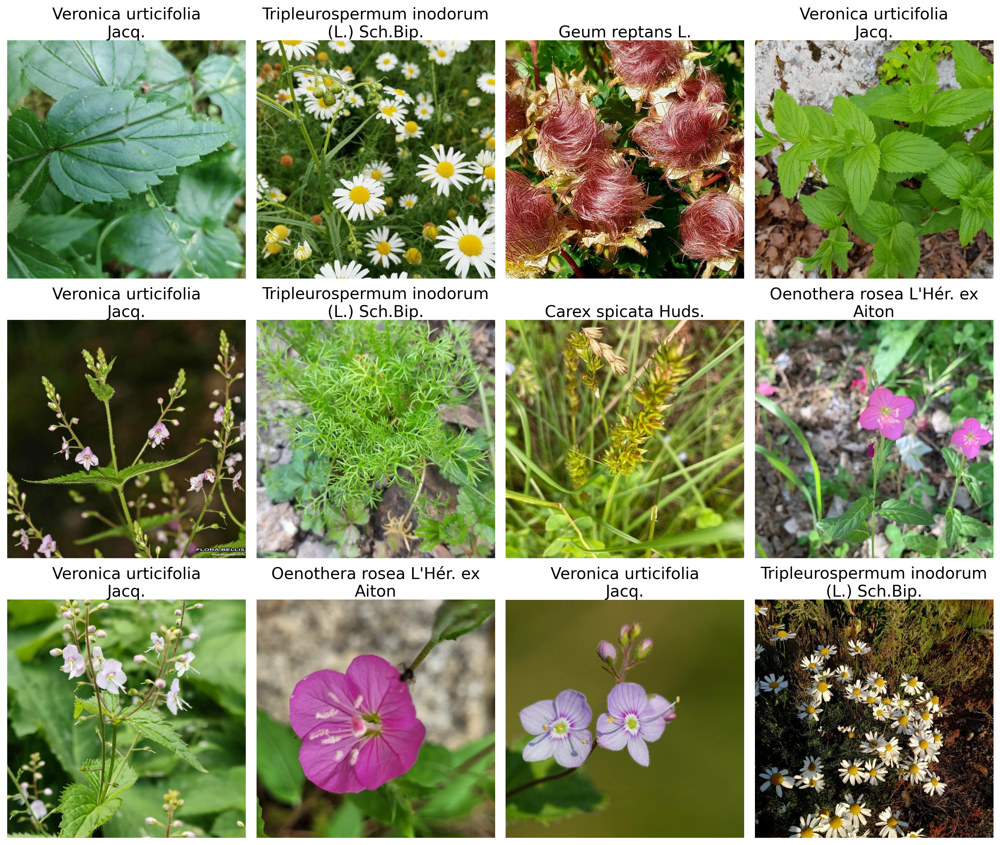

In [34]:
# Display the images in a grid with binomial names
plot_images_from_binary(
    img_df,
    data_col="data",
    label_col="species",
    grid_size=(3, 4),
    crop_square=True,
    figsize=(14, 12),
    dpi=200,
)

In [38]:
species = img_df.select("species").distinct()
for sp in species.collect():
    print(sp.species)

Veronica urticifolia Jacq.
Tripleurospermum inodorum (L.) Sch.Bip.
Geum reptans L.
Carex spicata Huds.
Oenothera rosea L'Hér. ex Aiton
Lamium bifidum Cirillo
